In [ ]:
import os, sys, json
from tqdm import tqdm
import numpy as np
import pandas as pd
import PIL
from PIL import Image

import umap
from sklearn.manifold import TSNE

import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib as mpl

%matplotlib notebook

#mpl.rcParams['figure.dpi'] = 300
#mpl.rcParams['figure.figsize'] = (8,8)

In [2]:
import torchvision.models as models
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from torch.autograd import Variable

normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
scaler = transforms.Resize((224, 224))
to_tensor = transforms.ToTensor()

class ResNet18():
    def __init__(self):
        self.model = models.resnet18(pretrained=True)
        self.feature_layer = self.model._modules.get('avgpool')
        self.model.eval()

    def extract_feature(self, img):
        img_tensor = to_tensor(scaler(img))
        if img_tensor.shape[0] == 1:
            img_tensor = img_tensor.repeat(3, 1, 1)
            
        img = Variable(normalize(img_tensor).unsqueeze(0))
        embedding = torch.zeros(512)
        def hook(m, i, o):
            feature_data = o.data.reshape((512))
            embedding.copy_(feature_data)
        h = self.feature_layer.register_forward_hook(hook)
        self.model(img)
        h.remove()
        embedding_fp16 = np.array(embedding.numpy(), dtype=np.float16)
        return embedding_fp16

In [3]:
resnet = ResNet18()

In [15]:
IMG_DIR='tattle-cluster-images'
img_vecs = []
thumbnails = []
img_list = os.listdir(IMG_DIR)
for img_name in tqdm(img_list):
    try:
        img = PIL.Image.open(os.path.join(IMG_DIR,img_name))
        vec = resnet.extract_feature(img)
        img.thumbnail((150,150), PIL.Image.ANTIALIAS)
        thumbnails.append(img)
        img_vecs.append(vec)
    except:
        print(f"skipping {img_name}")

100%|██████████| 2414/2414 [01:17<00:00, 31.08it/s]


In [16]:
X = np.array(img_vecs)

In [17]:
tsne_embeddings = TSNE(n_components=2, learning_rate=150, perplexity=20, angle=0.2, verbose=2).fit_transform(X)

# x1 = tsne_embeddings[:,0]
# y1 = tsne_embeddings[:,1]
# plt.clf()
# plt.scatter(x1, y1)

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 2414 samples in 0.001s...
[t-SNE] Computed neighbors for 2414 samples in 0.130s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2414
[t-SNE] Computed conditional probabilities for sample 2000 / 2414
[t-SNE] Computed conditional probabilities for sample 2414 / 2414
[t-SNE] Mean sigma: 3.194619
[t-SNE] Computed conditional probabilities in 0.074s
[t-SNE] Iteration 50: error = 82.8524628, gradient norm = 0.0201135 (50 iterations in 0.498s)
[t-SNE] Iteration 100: error = 82.8367233, gradient norm = 0.0130271 (50 iterations in 0.559s)
[t-SNE] Iteration 150: error = 81.5218048, gradient norm = 0.0150655 (50 iterations in 0.402s)
[t-SNE] Iteration 200: error = 81.3293610, gradient norm = 0.0103542 (50 iterations in 0.371s)
[t-SNE] Iteration 250: error = 81.2480164, gradient norm = 0.0094915 (50 iterations in 0.331s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.248016
[t-SNE] Iteration 300: erro

In [10]:
# umap_embeddings = umap.UMAP(n_neighbors=10, min_dist=0.2, n_jobs=16, metric='correlation').fit_transform(X)
# # x2 = umap_embeddings[:,0]
# # y2 = umap_embeddings[:,1]
# # plt.clf()
# # plt.scatter(x2, y2)

<IPython.core.display.Javascript object>


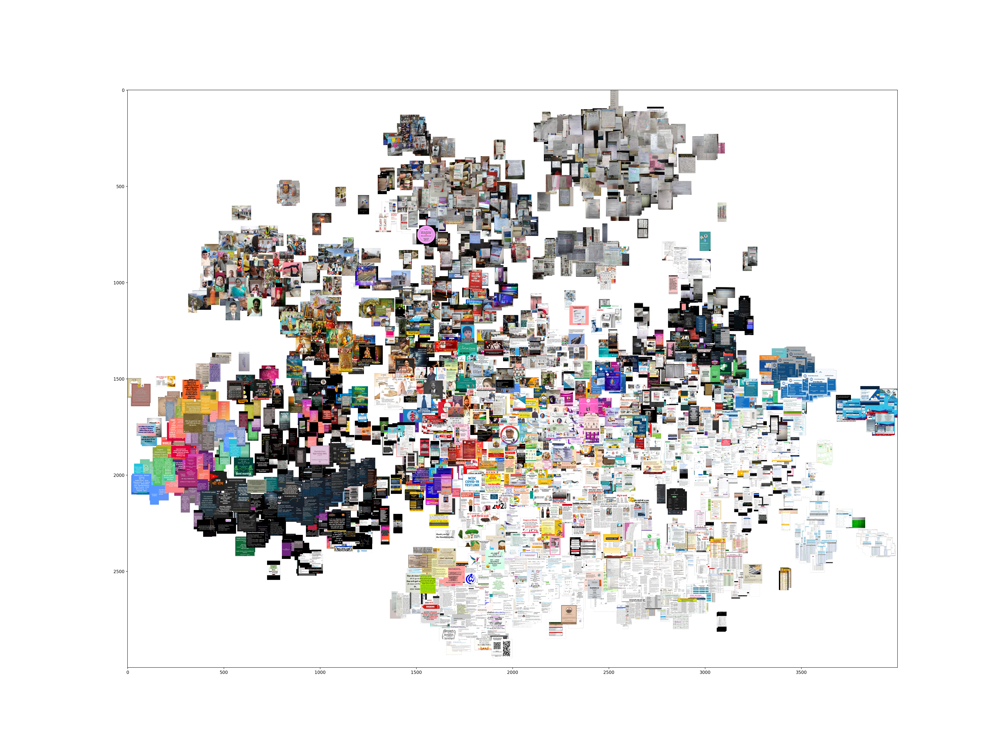

In [18]:
tx, ty = tsne_embeddings[:,0], tsne_embeddings[:,1]

tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
ty = (ty-np.min(ty)) / (np.max(ty) - np.min(ty))

width = 4000
height = 3000
max_dim = 100


full_image = Image.new('RGBA', (width, height))
for img, x, y in zip(img_list, tx, ty):
    tile = Image.open(os.path.join(IMG_DIR, img))
    rs = max(1, tile.width/max_dim, tile.height/max_dim)
    tile = tile.resize((int(tile.width/rs), int(tile.height/rs)), Image.ANTIALIAS)
    full_image.paste(tile, (int((width-max_dim)*x), int((height-max_dim)*y)), mask=tile.convert('RGBA'))
    #json_dict['images'].append(img)
    
plt.figure(figsize = (16,12))
plt.imshow(full_image)


In [19]:
json_dict = {'images':img_list, 'x':tx.tolist(), 'y':ty.tolist()}
json.dump(json_dict, fp=open('img_embeddings.json','w'))

<IPython.core.display.Javascript object>


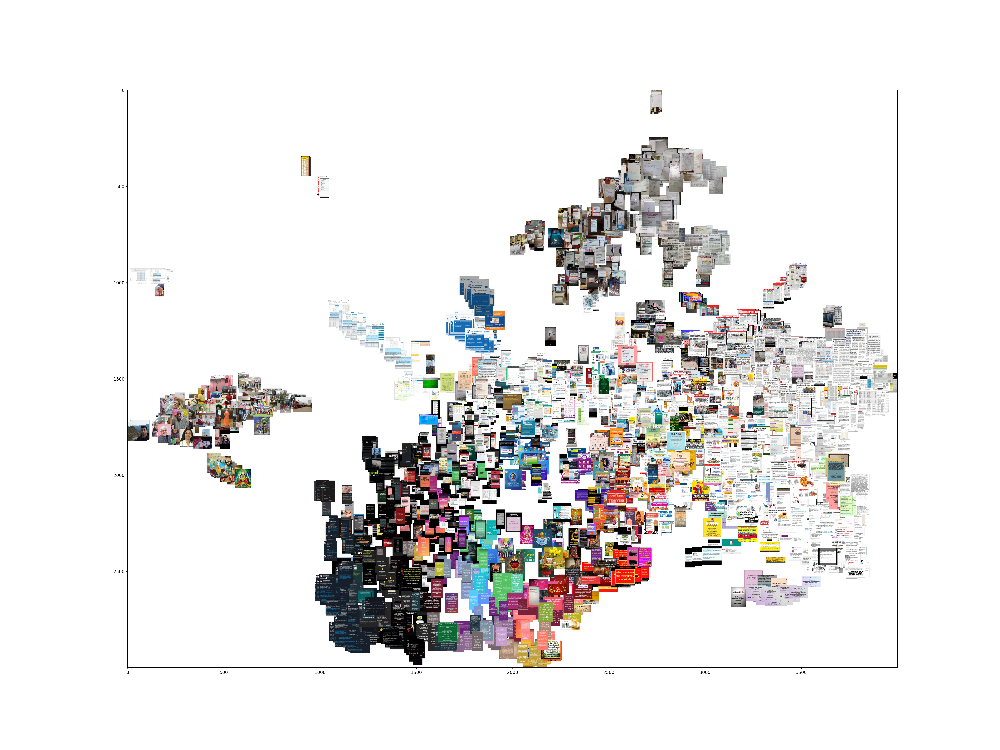

In [82]:
tx, ty = umap_embeddings[:,0], umap_embeddings[:,1]

json_dict = {'images':img_list, 'x':tx.tolist(), 'y':ty.tolist()}

tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
ty = (ty-np.min(ty)) / (np.max(ty) - np.min(ty))

width = 4000
height = 3000
max_dim = 100


full_image = Image.new('RGBA', (width, height))
for img, x, y in zip(img_list, tx, ty):
    tile = Image.open(os.path.join(IMG_DIR, img))
    rs = max(1, tile.width/max_dim, tile.height/max_dim)
    tile = tile.resize((int(tile.width/rs), int(tile.height/rs)), Image.ANTIALIAS)
    full_image.paste(tile, (int((width-max_dim)*x), int((height-max_dim)*y)), mask=tile.convert('RGBA'))
    json_dict['images'].append(img)
    
json.dump(json_dict, fp=open('img_embeddings.json','w'))
    
plt.figure(figsize = (16,12))
plt.imshow(full_image)
